<a href="https://colab.research.google.com/github/Paridhi-shukla/DA_HA/blob/main/Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Loading and preprocessing data...
Performing silhouette method...


Calculating silhouette scores: 100%|██████████| 9/9 [06:54<00:00, 46.07s/it]


Plotting silhouette scores...


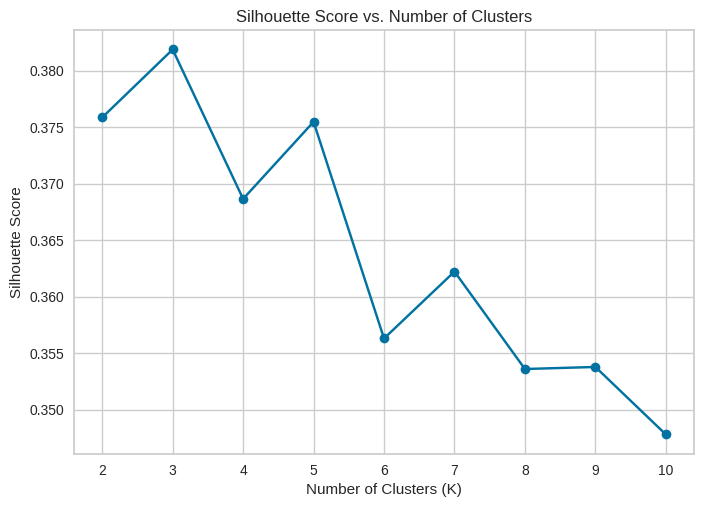

The optimal number of clusters (K) is: 3
The silhouette scores are: [0.37585831651930024, 0.3818729261642571, 0.3686566316267615, 0.37547596824625235, 0.3563117498922832, 0.36222825237538314, 0.35361122425628133, 0.35379355185133593, 0.34782186136245236]


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from tqdm import tqdm

def load_data(file_path):
    # Load the CSV file
    df = pd.read_csv(file_path)
    return df

def preprocess_data(df):
    # Convert 'peak time' to datetime if it's not already
    df['peak time'] = pd.to_datetime(df['peak time'])

    # Extract relevant features
    features = df[['peak time', 'peak(dB)']].copy()

    # Convert 'peak time' to a numeric value (seconds since epoch)
    features['peak time'] = features['peak time'].astype(np.int64) / 10**9

    # Normalize the features
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(features)

    return scaled_features

def silhouette_method(data, max_k=10, sample_size=60000):
    silhouette_scores = []
    k_values = range(2, max_k + 1)  # Start from 2 as silhouette score is not defined for k=1

    # If the dataset is too large, use a sample
    if len(data) > sample_size:
        data = data[np.random.choice(data.shape[0], sample_size, replace=False)]

    for k in tqdm(k_values, desc="Calculating silhouette scores"):
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        cluster_labels = kmeans.fit_predict(data)
        silhouette_avg = silhouette_score(data, cluster_labels)
        silhouette_scores.append(silhouette_avg)

    return k_values, silhouette_scores

def plot_silhouette_scores(k_values, silhouette_scores):
    plt.plot(k_values, silhouette_scores, 'bo-')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('Silhouette Score')
    plt.title('Silhouette Score vs. Number of Clusters')
    plt.grid(True)
    plt.show()

def find_optimal_k(k_values, silhouette_scores):
    return k_values[np.argmax(silhouette_scores)]

def main(file_path):
    print("Loading and preprocessing data...")
    df = load_data(file_path)
    scaled_features = preprocess_data(df)

    print("Performing silhouette method...")
    k_values, silhouette_scores = silhouette_method(scaled_features)

    print("Plotting silhouette scores...")
    plot_silhouette_scores(k_values, silhouette_scores)

    optimal_k = find_optimal_k(k_values, silhouette_scores)
    print(f"The optimal number of clusters (K) is: {optimal_k}")

    silhouette_score_result = silhouette_scores
    print(f"The silhouette scores are: {silhouette_score_result}")

if __name__ == "__main__":
    file_path = "/content/iris-event-list.csv"
    main(file_path)


<ipython-input-65-3bd032e1178a>:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



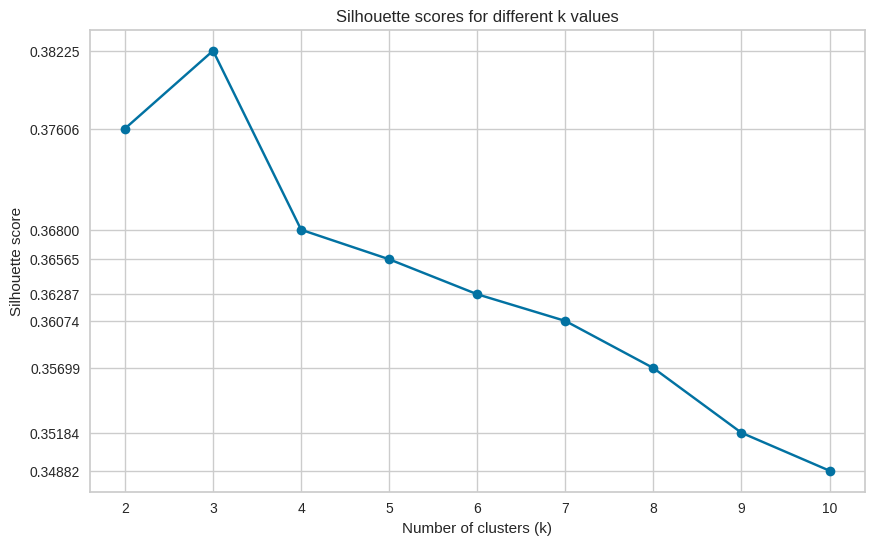

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import SilhouetteVisualizer

# Provided k_values and silhouette_scores
k_values = [2, 3, 4, 5, 6, 7, 8, 9, 10]
silhouette_scores = [0.3760557293287232, 0.38225229724522414, 0.36800015251486506, 0.36564987570394836, 0.3628659477370835, 0.3607424374892994, 0.35699145739005145, 0.3518393495419972, 0.34882012695406117]

# Load dataset
file_path = "/content/iris-event-list.csv"
df = pd.read_csv(file_path)

# Convert 'peak time' to datetime if it's not already
df['peak time'] = pd.to_datetime(df['peak time'])

# Extract relevant features
features = df[['peak time', 'peak(dB)']]

# Convert 'peak time' to a numeric value (seconds since epoch)
features['peak time'] = features['peak time'].astype(int) / 10**9

# Normalize the features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)

# Plot silhouette scores for different k values
plt.figure(figsize=(10, 6))
plt.plot(k_values, silhouette_scores, 'bo-')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette score')
plt.title('Silhouette scores for different k values')
plt.xticks(k_values)
plt.yticks(silhouette_scores)
plt.grid(True)
plt.show()

# Silhouette analysis visualizations for a subset of k-values
#fig, ax = plt.subplots(2, 2, figsize=(15, 20))
#subset_k_values = k_values[:4]  # Limiting to first 4 k-values for visualization

#for i, k in enumerate(subset_k_values):
#    kmeans = KMeans(n_clusters=k, init='k-means++', n_init=10, max_iter=100, random_state=42)
#    q, mod = divmod(i, 2)
#    visualizer = SilhouetteVisualizer(kmeans, colors='yellowbrick', ax=ax[q][mod])
#    visualizer.fit(scaled_features)

#plt.tight_layout()
#plt.show()


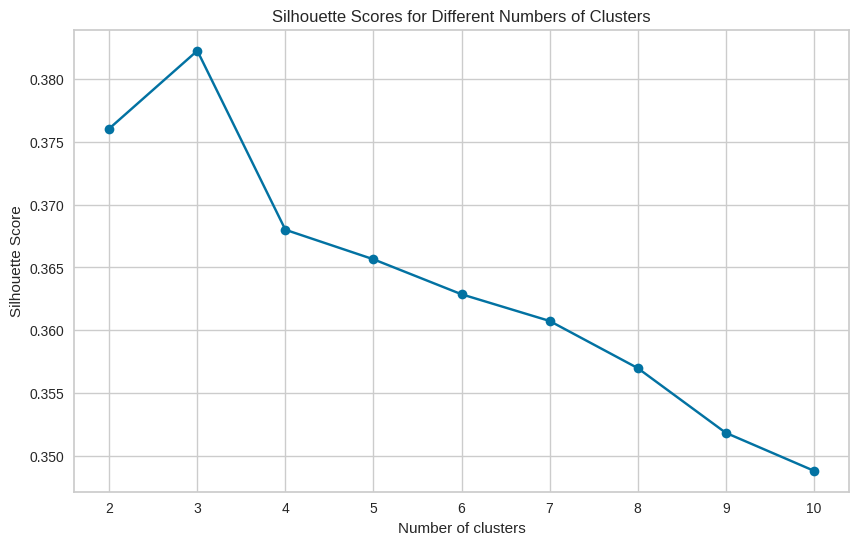

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
import plotly.graph_objects as go

# Extracting relevant columns for clustering
X = df[['background(dB)', 'peak(dB)']]

# Standardizing the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Plotting silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(k_values, silhouette_scores, marker='o')
plt.title('Silhouette Scores for Different Numbers of Clusters')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

# Assuming k=3 from silhouette score for the 3D plot
kmeans = KMeans(n_clusters=3)
labels = kmeans.fit_predict(X_scaled)

# 3D plot
figure_3D = go.Figure()

figure_3D.add_trace(go.Scatter3d(
    x=X_scaled[:, 0],
    y=X_scaled[:, 1],
    z=data.index,  # Using index as third dimension for demonstration
    mode='markers',
    marker=dict(
        size=10,
        color=labels,  # Color by cluster labels
        colorscale='Viridis',
        opacity=0.8
    )
))

figure_3D.update_layout(
    scene=dict(
        xaxis=dict(title='Background (dB)'),
        yaxis=dict(title='Peak (dB)'),
        zaxis=dict(title='Index')
    ),
    margin=dict(l=0, r=0, b=0, t=0),
    height=800,
    width=800
)

figure_3D.show()


In [ ]:
!pip install matplotlib
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from matplotlib.animation import FuncAnimation
from datetime import datetime, timedelta

cluster_data = pd.read_csv('/content/result.csv')

station_coords = pd.read_csv('/content/IRIS_station_list.csv')

cluster_data.columns = cluster_data.columns.str.strip()
station_coords.columns = station_coords.columns.str.strip()

# Print column names to verify
print("Cluster Data Columns: ", cluster_data.columns)
print("Station Coords Columns: ", station_coords.columns)

if 'station' in cluster_data.columns and 'station' in station_coords.columns:
    # Merge dataframes on 'station' column
    data = pd.merge(cluster_data, station_coords, on='station')

    # Convert start_time and end_time to datetime with specified format
    time_columns = ['start_time', 'end_time']
    date_format = '%d/%m/%y %H:%M:%S %p'  # Corrected format string

    for col in time_columns:
        data[col] = pd.to_datetime(data[col], format=date_format, errors='coerce')

    # Print and check for NaT values
    print("Minimum start_time:", data['start_time'].min())
    print("Maximum end_time:", data['end_time'].max())

    # Identify rows with NaT values
    nat_rows = data[data[time_columns].isna().any(axis=1)]
    print("Rows with NaT values in time columns:")
    print(nat_rows)

    # Drop rows with NaT values in start_time or end_time
    data = data.dropna(subset=time_columns)

    # Check again for NaT values after dropping
    if data[time_columns].isna().any().any():
        raise ValueError("There are still NaT values after attempting to drop them.")

    # Print the minimum and maximum start_time and end_time to verify
    print("Minimum start_time:", data['start_time'].min())
    print("Maximum end_time:", data['end_time'].max())

    # Calculate the duration
    start_time = data['start_time'].min()
    end_time = data['end_time'].max()

    # Ensure that start_time and end_time are not NaT
    if pd.isna(start_time) or pd.isna(end_time):
        raise ValueError("Start time or end time contains NaT values.")

    duration = (end_time - start_time).total_seconds()
    print("Duration in seconds:", duration)

    # Setup the figure and axis for plotting
    fig = plt.figure(figsize=(15, 10))
    ax = plt.axes(projection=ccrs.LambertConformal())
    ax.set_extent([-130, -60, 25, 60], crs=ccrs.PlateCarree())

    ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.OCEAN)
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.STATES, linestyle=':')

    ax.scatter(data['longitude'], data['latitude'], transform=ccrs.PlateCarree(),
               color='gray', s=10, alpha=0.5, label='Stations')

    fps = 30
    if duration > 0:
        frames = int((duration / (7 * 24 * 60 * 60)) * fps * 5)
    else:
        raise ValueError("Duration is not greater than 0, check the input data.")

    def update(frame):
        current_time = start_time + timedelta(seconds=frame * duration / frames)
        ax.set_title(f'Infrasound Activity - {current_time.strftime("%d/%m/%Y %H:%M:%S %p")}')

        current_data = data[(data['start_time'] <= current_time) & (data['end_time'] >= current_time)]

        for collection in ax.collections[1:]:
            collection.remove()

        for cluster in current_data['cluster'].unique():
            cluster_points = current_data[current_data['cluster'] == cluster]
            ax.scatter(cluster_points['longitude'], cluster_points['latitude'],
                       transform=ccrs.PlateCarree(),
                       s=cluster_points['max_peak_dB'] * 2,
                       alpha=0.7,
                       c=f'C{cluster}',
                       label=f'Cluster {cluster}')
            ax.legend()

        return ax

    anim = FuncAnimation(fig, update, frames=frames, interval=1000/fps, blit=False)

    anim.save('infrasound_animation.mp4', writer='ffmpeg', fps=fps)

    plt.close(fig)
    print("Animation saved as 'infrasound_animation.mp4'")
else:
    print("Error: 'station' column not found in one of the dataframes.")

Cluster Data Columns:  Index(['Unnamed: 0', 'station', 'cluster', 'mean_peak_dB', 'max_peak_dB',
       'mean_duration', 'mean_background_dB', 'max_background_dB', 'mean_snr',
       'max_snr', 'max_duration', 'start_time', 'end_time'],
      dtype='object')
Station Coords Columns:  Index(['station', 'latitude', 'longitude'], dtype='object')
Minimum start_time: NaT
Maximum end_time: NaT
Rows with NaT values in time columns:
Empty DataFrame
Columns: [Unnamed: 0, station, cluster, mean_peak_dB, max_peak_dB, mean_duration, mean_background_dB, max_background_dB, mean_snr, max_snr, max_duration, start_time, end_time, latitude, longitude]
Index: []
Minimum start_time: NaT
Maximum end_time: NaT


ValueError: Start time or end time contains NaT values.

In [ ]:
pip install cartopy


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 30.0 MB/s eta 0:00:00


Common station values:
{'A04D', 'H38A', 'N54A', 'D54A', 'K40A', 'R54A', 'K49A', 'O56A', 'S48A', 'E43A', 'L41A', 'L02E', 'Q43A', 'C06D', '352A', 'O55A', 'K48A', 'X43A', 'O03E', 'G42A', 'W53A', 'ABTX', '959A', 'L40A', 'N59A', 'P55A', '450A', 'V46A', 'TIGA', 'N46A', 'Z52A', 'N44A', 'F48A', 'J40A', '252A', 'T54A', 'I03D', 'H04D', 'J48A', 'V51A', 'O50A', '355A', 'G39A', 'T44A', 'R41A', 'X58A', 'V42A', 'M46A', '155A', 'P45A', '062Z', 'W45A', 'TUL1', 'U42A', 'M42A', 'N47A', 'X55A', 'MSTX', 'D47A', 'P48A', 'G38A', '758A', 'P43A', 'E44A', 'O42A', '554A', 'N43A', '350A', 'G40A', 'E50A', 'V47A', 'V52A', 'K43A', 'S52A', 'U44A', 'T47A', 'T42A', 'H17A', 'E38A', 'E48A', 'S49A', 'R51A', '121A', 'TCOL', 'D04E', '552A', 'Y54A', 'R50A', 'P49A', 'Y51A', 'L43A', 'D50A', 'D03D', 'J42A', 'N53A', 'M65A', 'X41A', 'N55A', 'F39A', 'V43A', '256A', 'U52A', 'P46A', 'D48A', 'Y22D', '757A', 'F05D', '147A', 'N45A', '153A', 'L46A', '859A', 'N41A', 'D46A', 'R43A', 'F37A', 'L49A', 'J49A', 'M45A', 'W47A', 'E53A', '858A', 

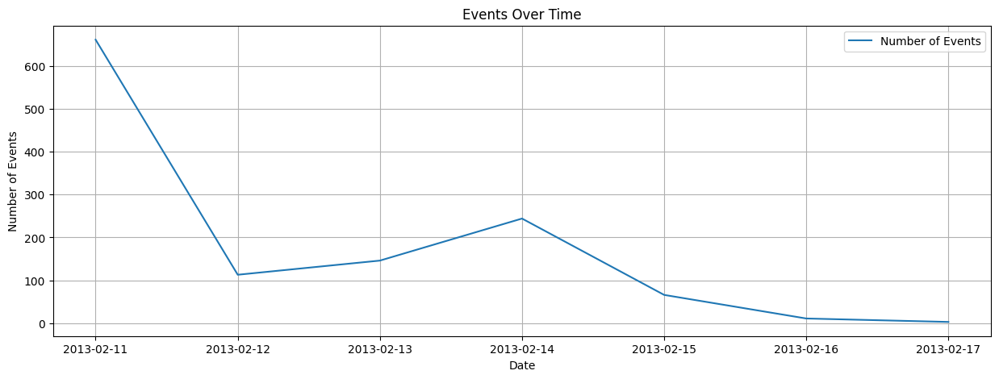

Daily peak values sample:
            max_peak_dB  mean_peak_dB  max_background_dB  mean_background_dB
start_time                                                                  
2013-02-11    -6.159109    -19.547834         -21.160192          -30.620607
2013-02-12    -8.495381    -20.909719         -21.916496          -31.548202
2013-02-13    -5.424966    -19.104849         -21.429082          -30.112636
2013-02-14    -6.748131    -21.042505         -21.733135          -31.826341
2013-02-15    -6.555924    -20.782386         -22.166818          -31.704428


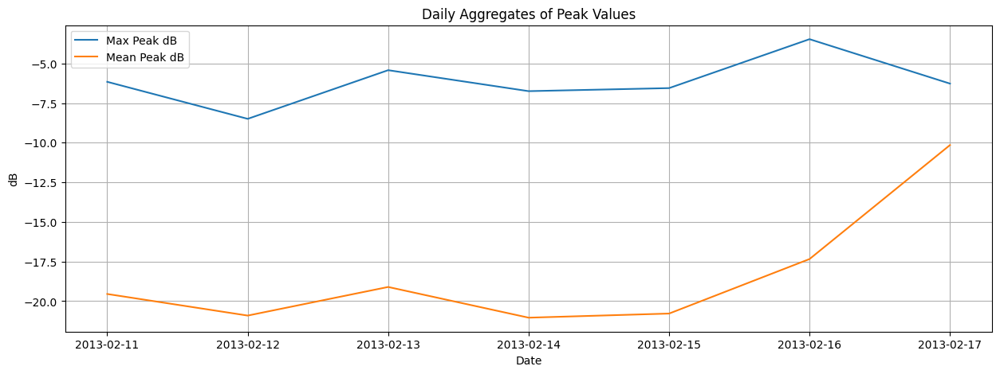

Hourly sensitivity sample:
                      mean_snr    max_snr
start_time                               
2013-02-11 00:00:00  11.084363  26.181808
2013-02-11 01:00:00  11.000649  25.875128
2013-02-11 02:00:00  10.027383  23.862154
2013-02-11 03:00:00  10.501494  24.614120
2013-02-11 04:00:00  11.072487  26.302435


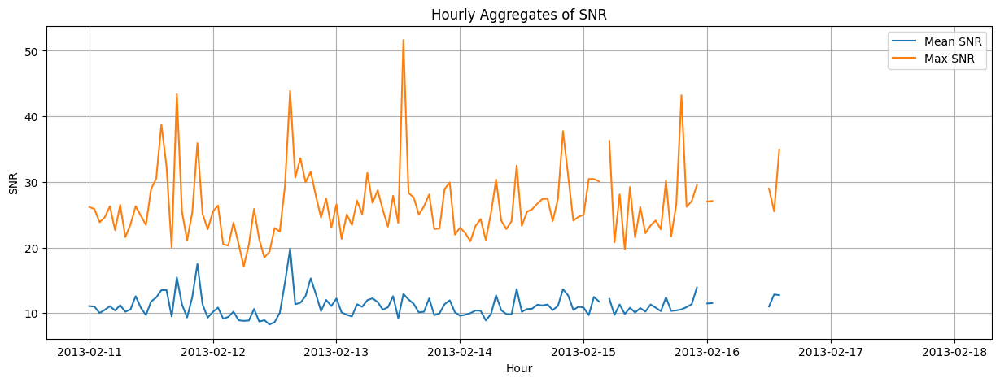

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime

# Load data
cluster_data = pd.read_csv('/content/result.csv')
station_coords = pd.read_csv('/content/iris-station-list.csv')

# Strip whitespace from column names
cluster_data.columns = cluster_data.columns.str.strip()
station_coords.columns = station_coords.columns.str.strip()

# the unique values in the 'station' column for both dataframes
#print("Unique station values in cluster_data:")
#print(cluster_data['station'].unique())


#print("Unique station values in station_coords:")
#print(station_coords['station'].unique())

common_stations = set(cluster_data['station']).intersection(set(station_coords['station']))

print("Common station values:")
print(common_stations)

if common_stations:
    # Proceed with merging if there are common stations
    data = pd.merge(cluster_data, station_coords, on='station')

    # Proceed with datetime conversion and further steps
    time_columns = ['start_time', 'end_time']
    date_format = '%Y-%m-%d %H:%M:%S'  # Adjusted format string

    for col in time_columns:
        data[col] = [datetime.strptime(date, date_format) for date in data[col]]
        data[col + '_ordinal'] = data[col].map(pd.Timestamp.toordinal)

    # Drop rows with NaT values in start_time or end_time
    data = data.dropna(subset=time_columns)

    # Check the conversion and NaT values
    print("Sample of 'start_time' and 'end_time' after conversion:")
    print(data[time_columns].head())
    print("NaT values count after conversion:")
    print(data[time_columns].isna().sum())
else:
    print("No common station values found. Check your data for mismatched station identifiers.")


if not data.empty:
    # Plot number of events over time
    data.set_index('start_time', inplace=True)

    events_over_time = data.resample('D').size()

    # Debug print the resampled data
    print("Events over time sample:")
    print(events_over_time.head())

    plt.figure(figsize=(15, 5))
    plt.plot(events_over_time, label='Number of Events')
    plt.xlabel('Date')
    plt.ylabel('Number of Events')
    plt.title('Events Over Time')
    plt.legend()
    plt.grid(True)
    plt.show()
else:
    print("Data is empty after datetime conversion.")

if not data.empty:
    # Daily aggregates for peak values
    daily_peak_values = data.resample('D').agg({
        'max_peak_dB': 'mean',
        'mean_peak_dB': 'mean',
        'max_background_dB': 'mean',
        'mean_background_dB': 'mean'
    })

    # Debug print the daily aggregates
    print("Daily peak values sample:")
    print(daily_peak_values.head())

    plt.figure(figsize=(15, 5))
    plt.plot(daily_peak_values['max_peak_dB'], label='Max Peak dB')
    plt.plot(daily_peak_values['mean_peak_dB'], label='Mean Peak dB')
    plt.xlabel('Date')
    plt.ylabel('dB')
    plt.title('Daily Aggregates of Peak Values')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Hourly aggregates for sensitivity
    hourly_sensitivity = data.resample('H').agg({
        'mean_snr': 'mean',
        'max_snr': 'mean'
    })

    # print the hourly aggregates
    print("Hourly sensitivity sample:")
    print(hourly_sensitivity.head())

    plt.figure(figsize=(15, 5))
    plt.plot(hourly_sensitivity['mean_snr'], label='Mean SNR')
    plt.plot(hourly_sensitivity['max_snr'], label='Max SNR')
    plt.xlabel('Hour')
    plt.ylabel('SNR')
    plt.title('Hourly Aggregates of SNR')
    plt.legend()
    plt.grid(True)
    plt.show()
else:
    print("Data is empty after datetime conversion.")



<ipython-input-47-8588ef792f15>:16: UserWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  result_df['start_time'] = pd.to_datetime(result_df['start_time'], format='%Y-%m-%d %H:%M:%S',  infer_datetime_format=True, errors='coerce')
<ipython-input-47-8588ef792f15>:17: UserWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  result_df['end_time'] = pd.to_datetime(result_df['end_time'], format='%Y-%m-%d %H:%M:%S',  infer_datetime_format=True, errors='coerce')
<ipython-input-47-8588ef792f15>:18: UserWarning: The argument 'infer_datetime_format' is deprecated and will be removed in

   Unnamed: 0 station  cluster  mean_peak_dB  max_peak_dB  mean_duration  \
0           0    058A        0    -12.191095        1.316      79.265574   
1           1    058A        1    -23.817238       -8.341      65.129293   
2           2    058A        2    -29.483051      -21.131      52.659341   
3           3    059A        0    -30.341070      -19.282      50.742816   
4           4    059A        1    -16.548686        4.329      75.212209   

   mean_background_dB  max_background_dB   mean_snr  max_snr  max_duration  \
0          -26.592531            -17.232  14.401436   33.764         537.0   
1          -34.940162            -24.442  11.122923   33.358         410.0   
2          -38.601480            -27.933   9.118429   18.158         294.0   
3          -40.412638            -27.967  10.071568   21.554         384.0   
4          -28.865499            -18.332  12.316812   31.106         858.0   

           start_time            end_time  
0 2013-02-13 14:32:31 2013-02-

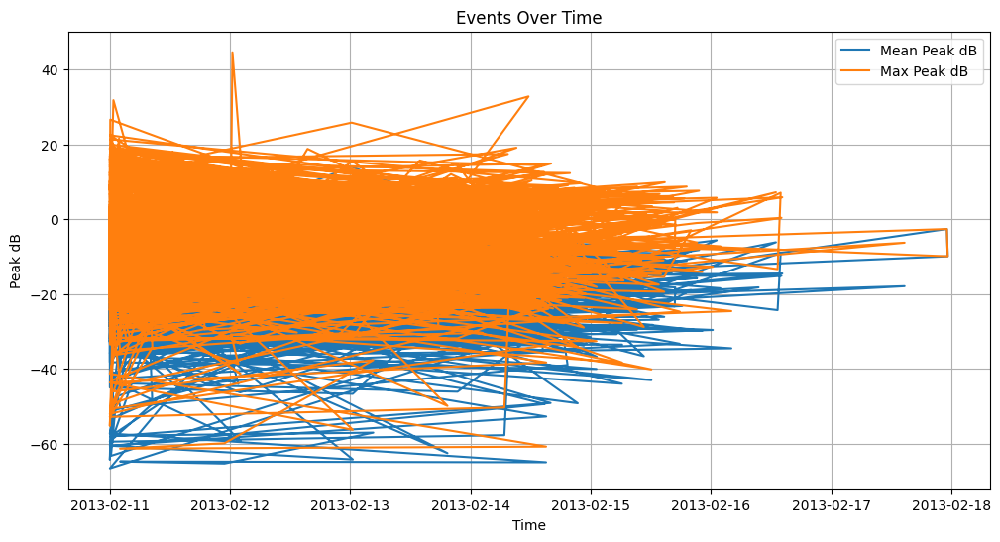

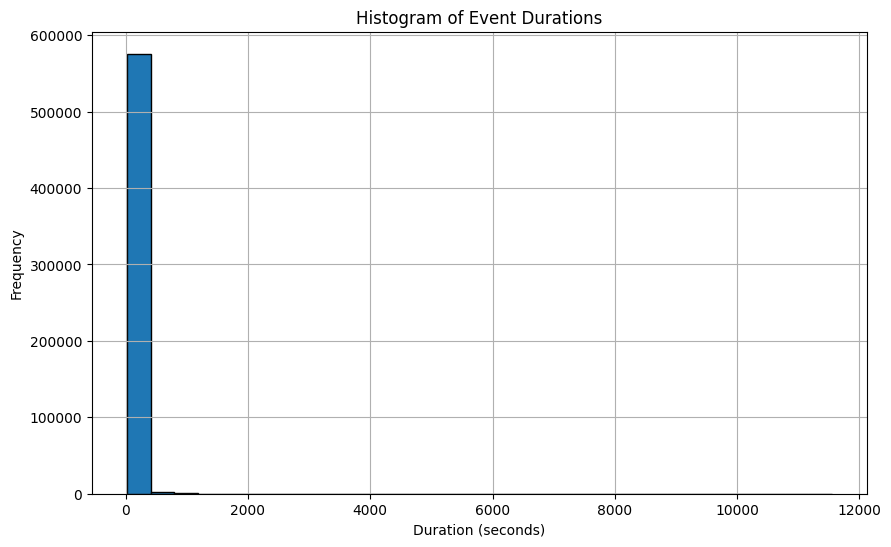

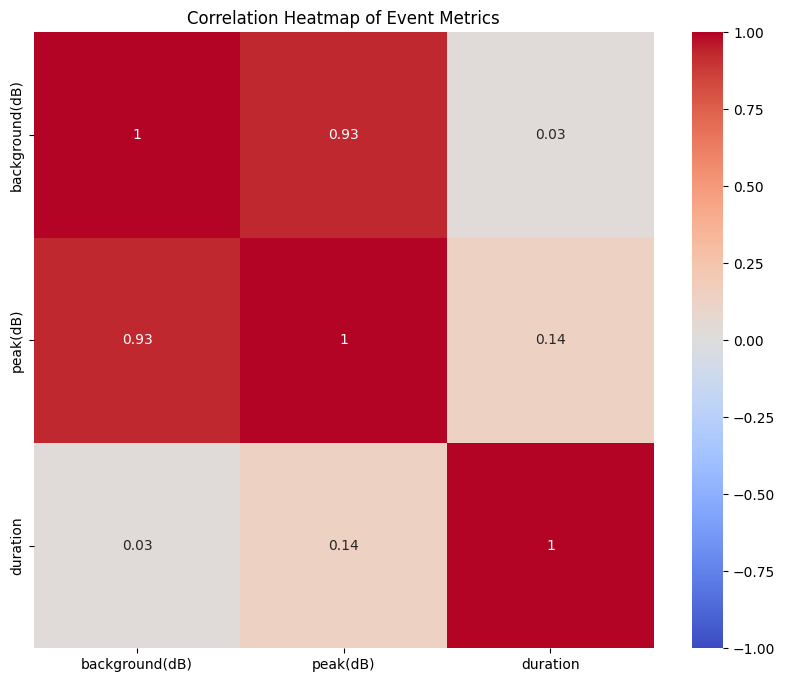

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


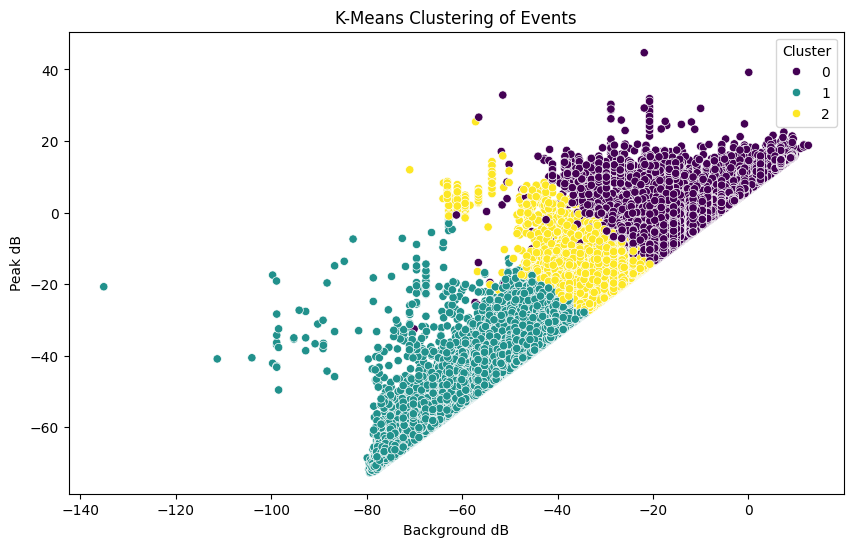

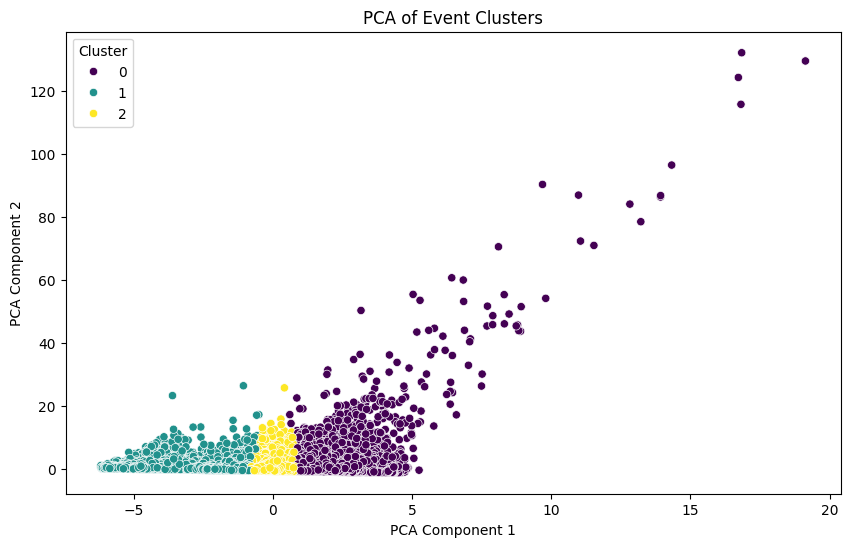

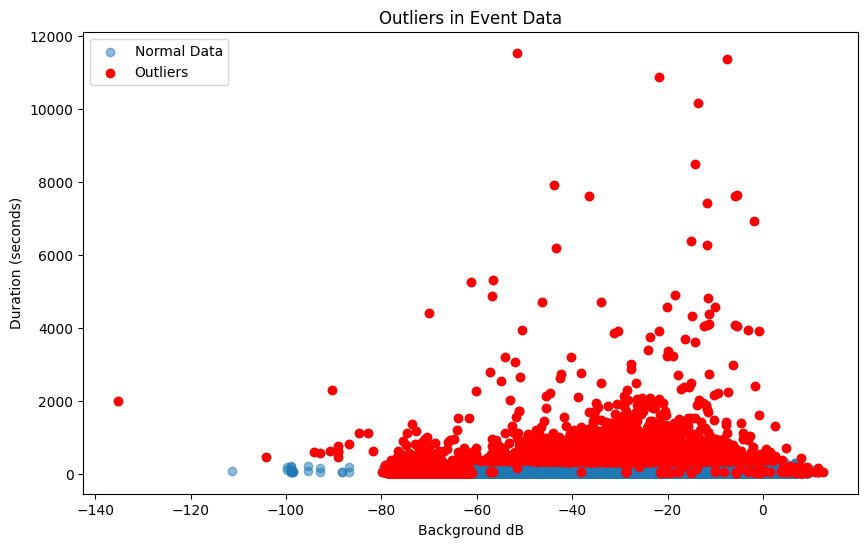

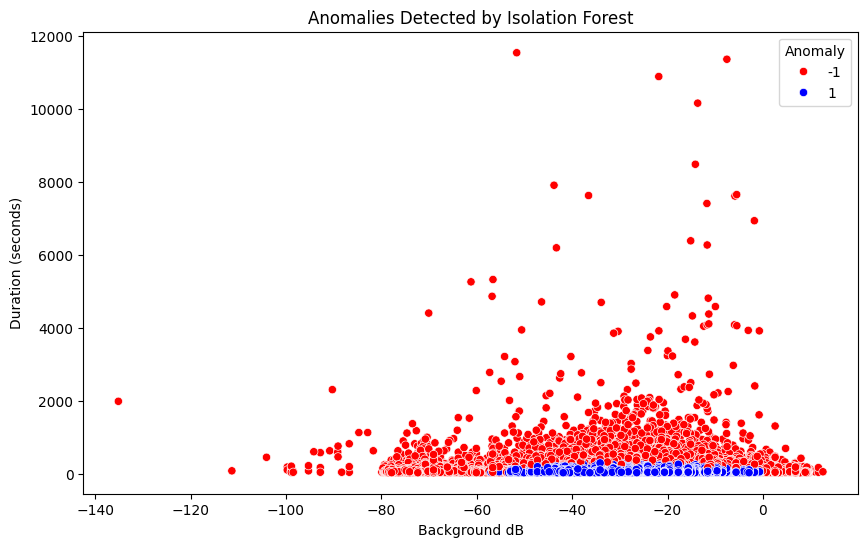

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from scipy.stats import zscore

# Load datasets
result_df = pd.read_csv('/content/result.csv')
event_df = pd.read_csv('/content/iris-event-list.csv')
station_df = pd.read_csv('/content/iris-station-list.csv')

# Convert datetime column
result_df['start_time'] = pd.to_datetime(result_df['start_time'], format='%Y-%m-%d %H:%M:%S',  infer_datetime_format=True, errors='coerce')
result_df['end_time'] = pd.to_datetime(result_df['end_time'], format='%Y-%m-%d %H:%M:%S',  infer_datetime_format=True, errors='coerce')
event_df['start time'] = pd.to_datetime(event_df['start time'], format='%Y-%m-%d %H:%M:%S',  infer_datetime_format=True, errors='coerce' )
event_df['peak time'] = pd.to_datetime(event_df['peak time'], format='%Y-%m-%d %H:%M:%S',  infer_datetime_format=True, errors='coerce')
event_df['end time'] = pd.to_datetime(event_df['end time'], format='%Y-%m-%d %H:%M:%S', infer_datetime_format=True, errors='coerce')

# Calculate duration
event_df['duration'] = (event_df['end time'] - event_df['start time']).dt.total_seconds()


# Print a summary to verify
print(result_df.head())
print(event_df.head())
print(station_df.head())

# Plot events over time
plt.figure(figsize=(12, 6))
plt.plot(result_df['start_time'], result_df['mean_peak_dB'], label='Mean Peak dB')
plt.plot(result_df['start_time'], result_df['max_peak_dB'], label='Max Peak dB')
plt.xlabel('Time')
plt.ylabel('Peak dB')
plt.title('Events Over Time')
plt.legend()
plt.grid(True)
plt.show()

# Aggregate data by day
#daily_aggregates = event_df.resample('d', on='start time').mean()
#hourly_aggregates = event_df.resample('H', on='start time').mean()

# Plot daily aggregates
#plt.figure(figsize=(12, 6))
#plt.plot(daily_aggregates.index, daily_aggregates['peak(dB)'], label='Daily Mean Peak dB')
#plt.xlabel('Day')
#plt.ylabel('Mean Peak dB')
#plt.title('Daily Aggregates of Peak dB')
#plt.legend()
#plt.grid(True)
#plt.show()

# Plot hourly aggregates
#plt.figure(figsize=(12, 6))
#plt.plot(hourly_aggregates.index, hourly_aggregates['peak(dB)'], label='Hourly Mean Peak dB')
#plt.xlabel('Hour')
#plt.ylabel('Mean Peak dB')
#plt.title('Hourly Aggregates of Peak dB')
#plt.legend()
#plt.grid(True)
#plt.show()

# Plot histogram of event durations
plt.figure(figsize=(10, 6))
plt.hist(event_df['duration'], bins=30, edgecolor='black')
plt.xlabel('Duration (seconds)')
plt.ylabel('Frequency')
plt.title('Histogram of Event Durations')
plt.grid(True)
plt.show()

# Correlation between peak values and background noise
correlation_matrix = event_df[['background(dB)', 'peak(dB)', 'duration']].corr()

# Plot heatmap of correlations
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap of Event Metrics')
plt.show()


# Features for clustering
features = event_df[['background(dB)', 'peak(dB)', 'duration']]

# Standardize features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)

# Apply K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
event_df['cluster_kmeans'] = kmeans.fit_predict(scaled_features)

# Plot clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x=event_df['background(dB)'], y=event_df['peak(dB)'], hue=event_df['cluster_kmeans'], palette='viridis')
plt.xlabel('Background dB')
plt.ylabel('Peak dB')
plt.title('K-Means Clustering of Events')
plt.legend(title='Cluster')
plt.show()

# Reduce to 2 dimensions with PCA
pca = PCA(n_components=2)
pca_features = pca.fit_transform(scaled_features)

# Plot PCA
plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_features[:, 0], y=pca_features[:, 1], hue=event_df['cluster_kmeans'], palette='viridis')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('PCA of Event Clusters')
plt.legend(title='Cluster')
plt.show()

# Calculate z-scores for peak values and duration
event_df['zscore_peak_dB'] = zscore(event_df['peak(dB)'])
event_df['zscore_duration'] = zscore(event_df['duration'])

# Identify outliers
outliers = event_df[(event_df['zscore_peak_dB'].abs() > 3) | (event_df['zscore_duration'].abs() > 3)]

# Plot outliers
plt.figure(figsize=(10, 6))
plt.scatter(event_df['background(dB)'], event_df['duration'], label='Normal Data', alpha=0.5)
plt.scatter(outliers['background(dB)'], outliers['duration'], color='red', label='Outliers')
plt.xlabel('Background dB')
plt.ylabel('Duration (seconds)')
plt.title('Outliers in Event Data')
plt.legend()
plt.show()

# Fit Isolation Forest
iso_forest = IsolationForest(contamination=0.05, random_state=42)
event_df['anomaly_iso_forest'] = iso_forest.fit_predict(scaled_features)

# Plot anomalies
plt.figure(figsize=(10, 6))
sns.scatterplot(x=event_df['background(dB)'], y=event_df['duration'], hue=event_df['anomaly_iso_forest'], palette={1: 'blue', -1: 'red'}, legend='full')
plt.xlabel('Background dB')
plt.ylabel('Duration (seconds)')
plt.title('Anomalies Detected by Isolation Forest')
plt.legend(title='Anomaly')
plt.show()




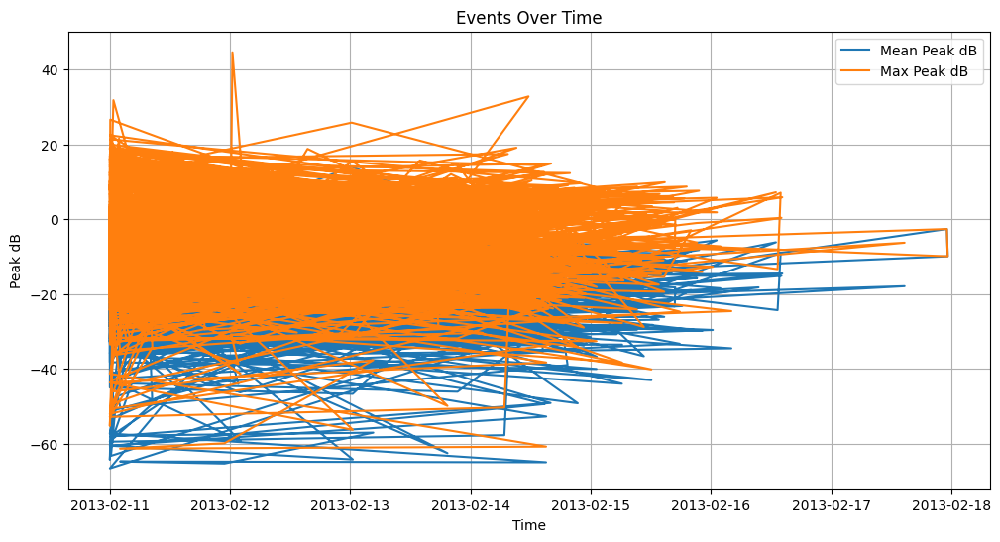

TypeError: Could not convert 060Z151A152A155A214A252A351A452A453A457A958AD41AE38AE42AF39AF43AH39AH42AI04AI40AI45AJ39AK04DK40AK51AKSCOL43AL44AM04CM43AM51AMSTXN50AO20AO47AO54AP46AQ52AR41AR44AR53AU43AV46AV50AX40A350A352AD47AI43AR54AT51AW42AY48A153A450AEPYKG38AJ05DK39AL48AP47AP49AP53AR49AR50ASFINTPFOU46AW44A349AG43AO03EP42AP45AP48AY51AZ54A156AE44AK22AL02EL47AO42AV42AX41AX50BY22D061Z552A859AE50AI42AS51AW47AW49AY49AY52A253AE04DJ49AM47AM50AN46AR11AR47AT53AU45AW53A554AE41AG41AI05DO44AR55AX42AZ51AE40AG39AJ48AM46AN59AQ50AU49AU50AW45AW50A957AF05DF49AI55AN02DN45A121AE47AE52AK49AR43AR46AS52AU47A059Z149AN50AS49ATIGAV45A059A152AH48AM52AN42AT50AJ41AL44A062Z449A556AP43AH41AO41AP41AJ46AM47AX43AJ45AM44ATCOLX51AY22DZ43AZ55A857AM41AR43AS50AH43AMDNDU48A556AF41AF51AN40AT49AU52AV48AE43AF46AG41AH56AK46AK48ATCOLV41A151A451A858AH55AO52AP44AP50AW48AN41AZ55AH38AI46AM42AM46AU53A658AG53AJ40AL53AN47A255A350A456AD50AM48AP51AU44A155AJ45AR48ATUL1Y43AY54AP50AW43A154AL42AN55AW18AY48A147A553AC40AE51AK52AM54AO45APOKR557AO55AK43AL46AR52AX48A150AF42AH04DQ55AV52AW49AX47A657AD54AF44AF48AJ01EL39AN52AF40AJ39AR53AT52A249AE42AI41AS53AK47A254AH56AO50AI51AO43AG53A149AE54AL48AO48A250A255AR50AW52AG40AU53AV44A251AN49AF05DO43AF44A349AJ47A357A448AX47A353AL50AF37AM49AU43A356AO56AP52AW46AF40AR51AW43AM53AY53AF04DR45AV47AM50AU44BPOKR156AD53AJ48AM02CX52AO20AP51AL04DP55AN54AX43AR42AZ49AM45AM65A555AD54AN48AQ51A214AZ50AI47AE48AU40AN54AN44AF55AM39AE45AV49AK55A256AI49AU48AL41AK41AL40AZ52AK02D153AQ51AU41AM54AM40AV51AE45ABGNEK49A059ZJ41A757A959AL50AV44AL40AL41A059AD48AW51AM51A058AI03DJ43AV43AG43AJ42AD48AE54AY42A454AV47AJ43AI39AE53A858A758AL04DL49AO54AO53AV53A257A557AI03D758A351AD46AN53AE51AEPYKH40AJ42AK42A145AG42A353AD51AI39AR47AY50A256AW51AW53AM49A657AR52AF55A455AG38AP55AO47AP52AMSTXU51AX53AD47AD53AH42AR44AP42AI52AI46AG03DY50AJ55AF45AL49AP53AU41A355AZ53A145AO53A958AP49A455AF42AZ54AI48A555AV45AL46AN53AK42AZ41AZ52AKMSCH39AD50A553ATUL1250AJ05DC06DE41AM53AN43AO55ASPMN655AR51AJ55AU42A656AU44B656ASUSD356AI53AF46AF43A251A060AR58BP45AE47AWHTXQ50AD41A061ZM52AK46AV51AI41AD46AABTXL47ATIGAW41B454A355AK52AW39AO02DV50AKSCOH43AJ47AF41AE48AF37A252AV48AH17AG40A655AU50A147A448AP44AY49AV52AR11AP43AU52AI48AW39AT50A757AQ52AU45A453AD04EH55AL02EA04DW48AU49AE38AY41AE43AM45AB05DV49AE50AD03DU42AS52AABTXJ46AI53AK47AN52AK51AT53AH38AE53AF38AY41AF38AU46AR54AJ49AO56AS50AX42AP48AQ55AF39AR49AR42AK48AW52AY42AT51AU47AS51AG39AU51AW50AI55AM48AH48AR41AO02D352AKMSCE39AO52A451AE39AT52AD51AR45AN55AJ40AMDNDW45AF49A554AH41AO50A060AX50BO44A658A257AA04D452AZ50A957AG42AH17AWHTXSUSDN59AU40AX40A859AR55AZ43AJ01EF48AG05DY54ASPMNE44AI02DI02D456AJ04DE52ATOLKV41AD03DC06DN40A457AW44AI45AM42AP47AX53A254AH40AO41AP41AR46AM39AO45AP46AO42AN41AR48A to numeric

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest

# Load dataset
result_df = pd.read_csv('/content/result.csv')

# Convert datetime columns
result_df['start_time'] = pd.to_datetime(result_df['start_time'])
result_df['end_time'] = pd.to_datetime(result_df['end_time'])

# Convert necessary columns to numeric and handle non-numeric values
numeric_columns = [
    'mean_peak_dB', 'max_peak_dB', 'mean_duration',
    'mean_background_dB', 'max_background_dB', 'mean_snr',
    'max_snr', 'max_duration'
]

for col in numeric_columns:
    result_df[col] = pd.to_numeric(result_df[col], errors='coerce')

# Plotting Events Over Time
plt.figure(figsize=(12, 6))
plt.plot(result_df['start_time'], result_df['mean_peak_dB'], label='Mean Peak dB')
plt.plot(result_df['start_time'], result_df['max_peak_dB'], label='Max Peak dB')
plt.xlabel('Time')
plt.ylabel('Peak dB')
plt.title('Events Over Time')
plt.legend()
plt.grid(True)
plt.show()

# Aggregate data by day and hour
result_df.set_index('start_time', inplace=True)  # Set datetime index for resampling

daily_aggregates = result_df.resample('D').mean()
hourly_aggregates = result_df.resample('H').mean()

# Plot daily aggregates
plt.figure(figsize=(12, 6))
plt.plot(daily_aggregates.index, daily_aggregates['mean_peak_dB'], label='Daily Mean Peak dB')
plt.xlabel('Day')
plt.ylabel('Mean Peak dB')
plt.title('Daily Aggregates of Peak dB')
plt.legend()
plt.grid(True)
plt.show()

# Plot hourly aggregates
plt.figure(figsize=(12, 6))
plt.plot(hourly_aggregates.index, hourly_aggregates['mean_peak_dB'], label='Hourly Mean Peak dB')
plt.xlabel('Hour')
plt.ylabel('Mean Peak dB')
plt.title('Hourly Aggregates of Peak dB')
plt.legend()
plt.grid(True)
plt.show()

# Histogram of Durations
plt.figure(figsize=(10, 6))
plt.hist(result_df['max_duration'].dropna(), bins=30, edgecolor='black')
plt.xlabel('Duration (seconds)')
plt.ylabel('Frequency')
plt.title('Histogram of Event Durations')
plt.grid(True)
plt.show()

# Correlation Analysis
correlation_matrix = result_df[numeric_columns].corr()

# Plot heatmap of correlations
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap')
plt.show()

# Clustering Analysis using K-Means
features = result_df[numeric_columns].dropna()

# Standardize features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)

# Apply K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
result_df['cluster_kmeans'] = kmeans.fit_predict(scaled_features)

# Plot clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x=result_df['mean_peak_dB'], y=result_df['max_peak_dB'], hue=result_df['cluster_kmeans'], palette='viridis')
plt.xlabel('Mean Peak dB')
plt.ylabel('Max Peak dB')
plt.title('K-Means Clustering of Events')
plt.legend(title='Cluster')
plt.show()

# Reduce to 2 dimensions with PCA for visualization
pca = PCA(n_components=2)
pca_features = pca.fit_transform(scaled_features)

# Plot PCA
plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_features[:, 0], y=pca_features[:, 1], hue=result_df['cluster_kmeans'], palette='viridis')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('PCA of Event Clusters')
plt.legend(title='Cluster')
plt.show()

# Anomaly Detection using Isolation Forest
iso_forest = IsolationForest(contamination=0.05, random_state=42)
result_df['anomaly_iso_forest'] = iso_forest.fit_predict(scaled_features)

# Plot anomalies detected by Isolation Forest
plt.figure(figsize=(10, 6))
sns.scatterplot(x=result_df['mean_peak_dB'], y=result_df['max_peak_dB'], hue=result_df['anomaly_iso_forest'], palette={1: 'blue', -1: 'red'}, legend='full')
plt.xlabel('Mean Peak dB')
plt.ylabel('Max Peak dB')
plt.title('Anomalies Detected by Isolation Forest')
plt.legend(title='Anomaly')
plt.show()
